<a href="https://colab.research.google.com/github/algoxrythm/EDA_NASA_TJED/blob/main/EDA_NASA_TJED.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Exploratory Data Analysis on NASA's Turbofan Jet Engine Dataset





In [4]:
from google.colab import files
uploaded = files.upload()


Saving train_FD001.txt to train_FD001.txt


In [5]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.feature_selection import VarianceThreshold

# Load with no header and space separator
df = pd.read_csv('train_FD001.txt', sep=' ', header=None)
df = df.dropna(axis=1, how='all')  # remove empty columns

# Rename columns
df.columns = ['unit', 'time_in_cycles'] + \
             [f'op_setting_{i}' for i in range(1, 4)] + \
             [f'sensor_{i}' for i in range(1, 22)]

df.head()


,unit,time_in_cycles,op_setting_1,op_setting_2,op_setting_3,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5,...,sensor_12,sensor_13,sensor_14,sensor_15,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,521.66,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,522.28,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,522.42,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,522.86,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,522.19,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044


In [6]:
df.info()
df.describe().T
df['unit'].nunique()  # How many engines?


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 20631 entries, 0 to 20630
Data columns (total 26 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   unit            20631 non-null  int64  
 1   time_in_cycles  20631 non-null  int64  
 2   op_setting_1    20631 non-null  float64
 3   op_setting_2    20631 non-null  float64
 4   op_setting_3    20631 non-null  float64
 5   sensor_1        20631 non-null  float64
 6   sensor_2        20631 non-null  float64
 7   sensor_3        20631 non-null  float64
 8   sensor_4        20631 non-null  float64
 9   sensor_5        20631 non-null  float64
 10  sensor_6        20631 non-null  float64
 11  sensor_7        20631 non-null  float64
 12  sensor_8        20631 non-null  float64
 13  sensor_9        20631 non-null  float64
 14  sensor_10       20631 non-null  float64
 15  sensor_11       20631 non-null  float64
 16  sensor_12       20631 non-null  float64
 17  sensor_13       20631 non-null 

100

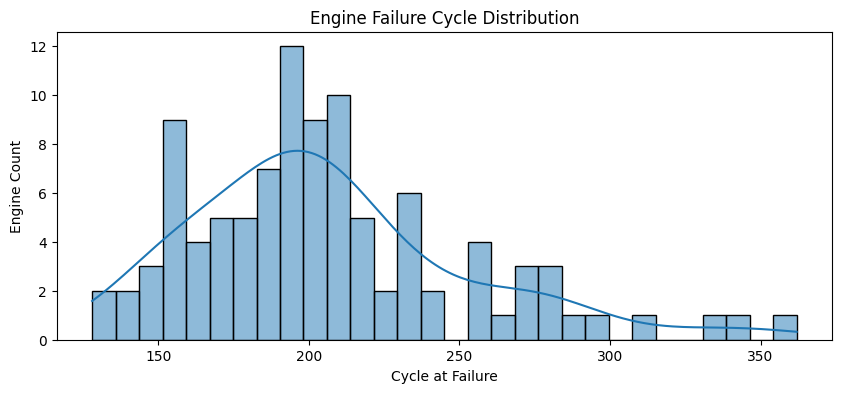

In [8]:
cycle_counts = df.groupby('unit')['time_in_cycles'].max()
plt.figure(figsize=(10, 4))
sns.histplot(cycle_counts, bins=30, kde=True)
plt.title('Engine Failure Cycle Distribution')
plt.xlabel('Cycle at Failure')
plt.ylabel('Engine Count')
plt.show()


In [10]:
rul = df.groupby('unit')['time_in_cycles'].max().reset_index()
rul.columns = ['unit', 'max_cycle']
df = df.merge(rul, on='unit')
df['RUL'] = df['max_cycle'] - df['time_in_cycles']
df.drop(columns='max_cycle', inplace=True)
df.head()


,unit,time_in_cycles,op_setting_1,op_setting_2,op_setting_3,sensor_1,sensor_2,sensor_3,sensor_4,sensor_5,...,sensor_13,sensor_14,sensor_15,sensor_16,sensor_17,sensor_18,sensor_19,sensor_20,sensor_21,RUL
0,1,1,-0.0007,-0.0004,100.0,518.67,641.82,1589.70,1400.60,14.62,...,2388.02,8138.62,8.4195,0.03,392,2388,100.0,39.06,23.4190,191
1,1,2,0.0019,-0.0003,100.0,518.67,642.15,1591.82,1403.14,14.62,...,2388.07,8131.49,8.4318,0.03,392,2388,100.0,39.00,23.4236,190
2,1,3,-0.0043,0.0003,100.0,518.67,642.35,1587.99,1404.20,14.62,...,2388.03,8133.23,8.4178,0.03,390,2388,100.0,38.95,23.3442,189
3,1,4,0.0007,0.0000,100.0,518.67,642.35,1582.79,1401.87,14.62,...,2388.08,8133.83,8.3682,0.03,392,2388,100.0,38.88,23.3739,188
4,1,5,-0.0019,-0.0002,100.0,518.67,642.37,1582.85,1406.22,14.62,...,2388.04,8133.80,8.4294,0.03,393,2388,100.0,38.90,23.4044,187


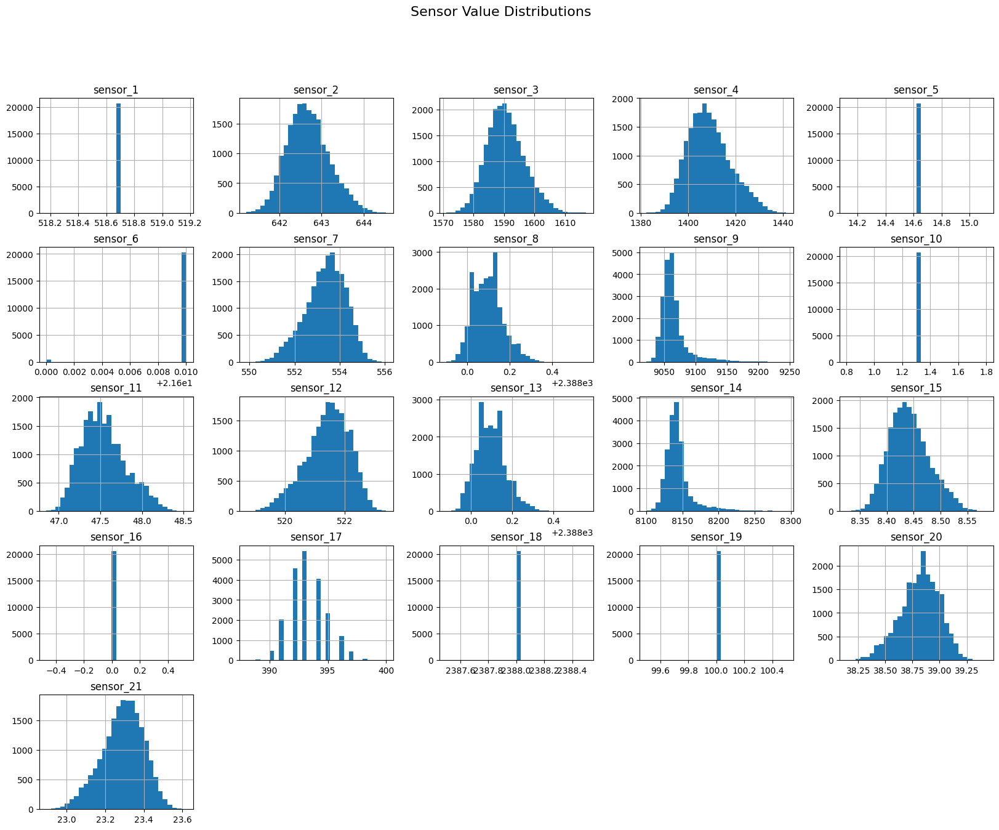

In [11]:
sensor_cols = [col for col in df.columns if 'sensor' in col]

df[sensor_cols].hist(bins=30, figsize=(20, 15), layout=(5, 5))
plt.suptitle('Sensor Value Distributions', fontsize=16)
plt.show()


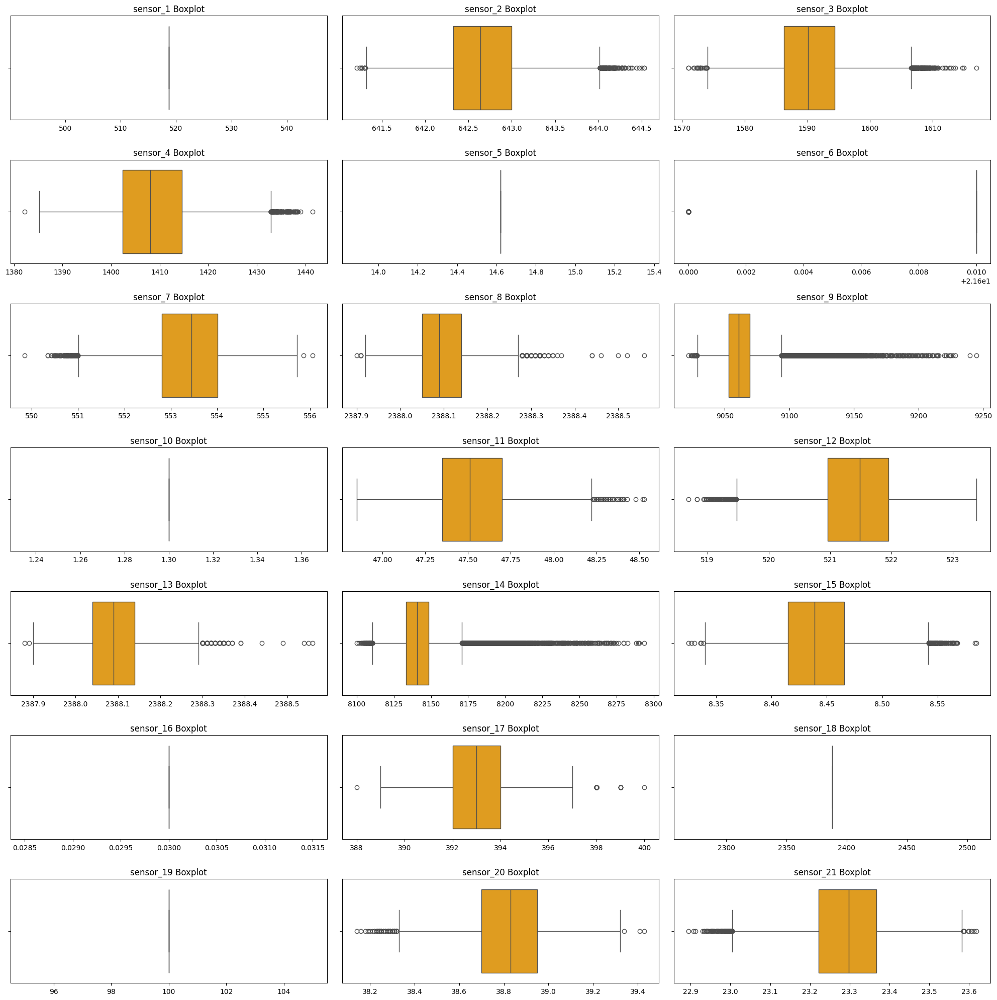

In [20]:
plt.figure(figsize=(20, 20))
for i, col in enumerate(sensor_cols, 1):
    plt.subplot(7, 3, i)
    sns.boxplot(x=df[col], color='orange')
    plt.title(f'{col} Boxplot')
    plt.xlabel('')
plt.tight_layout()
plt.show()


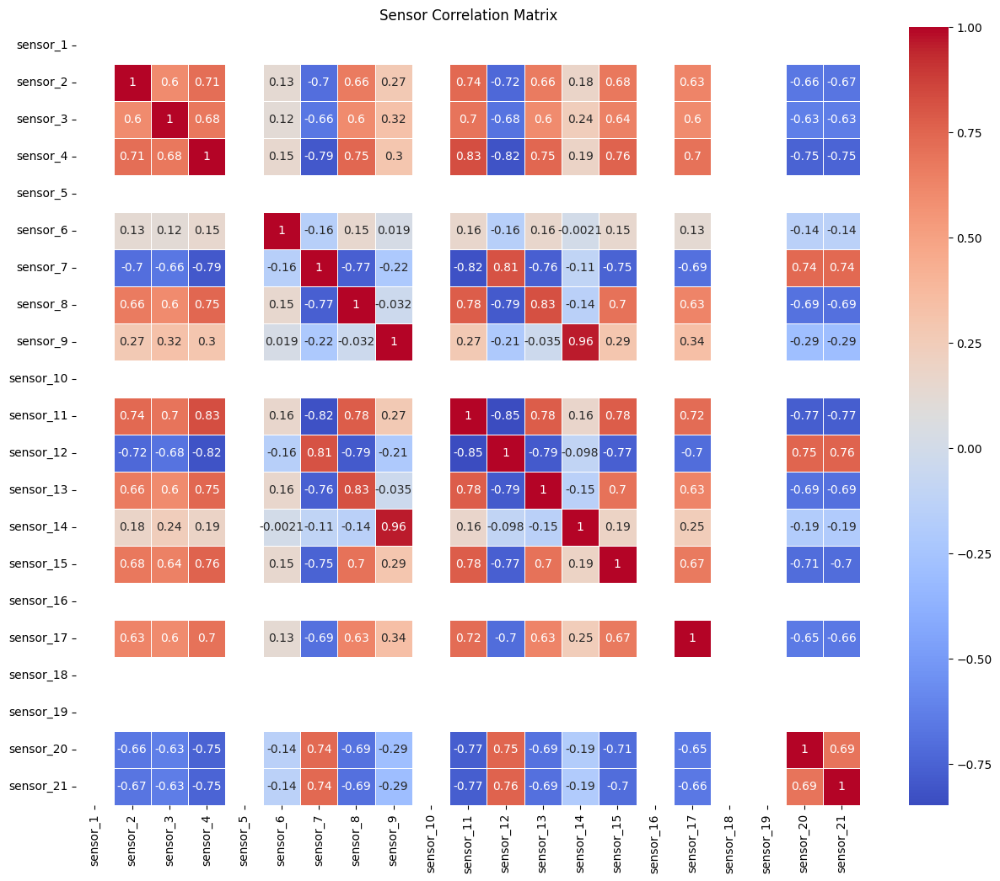

In [21]:
plt.figure(figsize=(15, 12))
corr = df[sensor_cols].corr()
sns.heatmap(corr, annot=True , cmap='coolwarm', linewidths=0.5)
plt.title("Sensor Correlation Matrix")
plt.show()


In [24]:
# Step: Add RUL (Remaining Useful Life) to each row
rul_df = df.groupby('unit')['time_in_cycles'].max().reset_index()
rul_df.columns = ['unit', 'max_cycle']
df = df.merge(rul_df, on='unit')
df['RUL'] = df['max_cycle'] - df['time_in_cycles']
df.drop(columns=['max_cycle'], inplace=True)


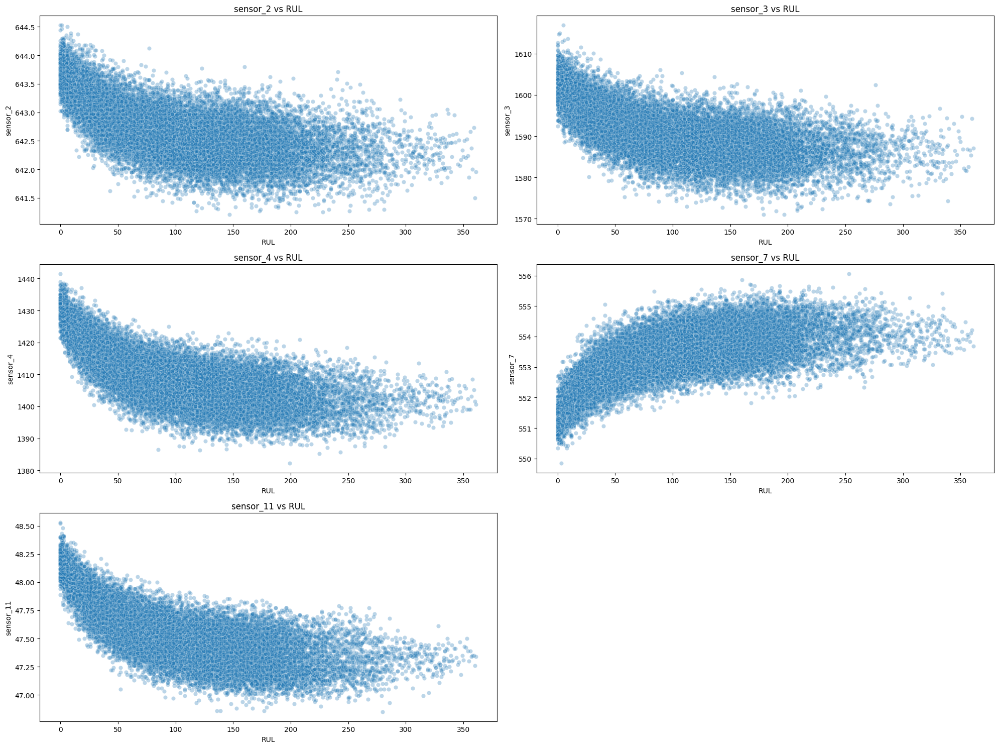

In [27]:
# Plot a few key sensors against RUL
import matplotlib.pyplot as plt
import seaborn as sns

# Pick a few sensors to visualize — you can change this list
selected_sensors = ['sensor_2', 'sensor_3', 'sensor_4', 'sensor_7', 'sensor_11']

plt.figure(figsize=(20, 15))

for i, sensor in enumerate(selected_sensors, 1):
    plt.subplot(3, 2, i)
    sns.scatterplot(data=df, x='RUL', y=sensor, alpha=0.3)
    plt.title(f'{sensor} vs RUL')
    plt.xlabel('RUL')
    plt.ylabel(sensor)

plt.tight_layout()
plt.show()


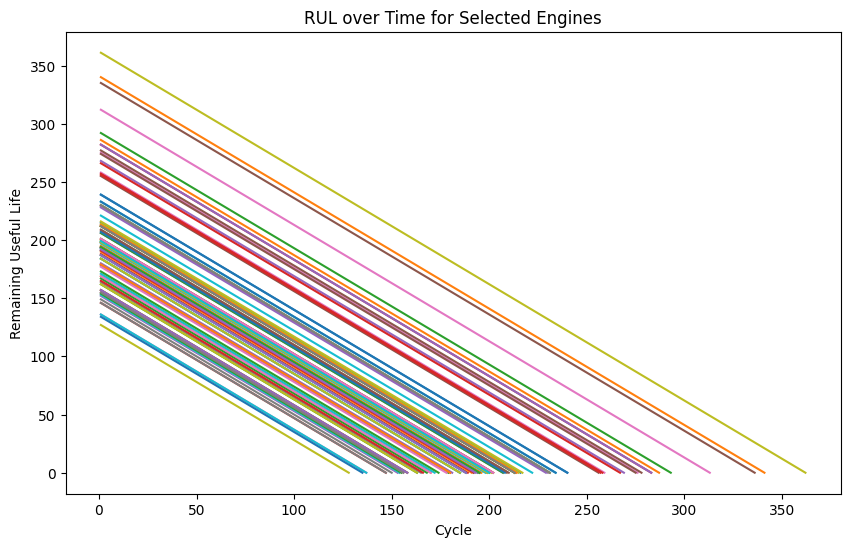

In [32]:
units = range(1, 101)
plt.figure(figsize=(10, 6))
for unit in units:
    temp = df[df['unit'] == unit]
    plt.plot(temp['time_in_cycles'], temp['RUL'])
plt.xlabel("Cycle")
plt.ylabel("Remaining Useful Life")
plt.title("RUL over Time for Selected Engines")
plt.show()

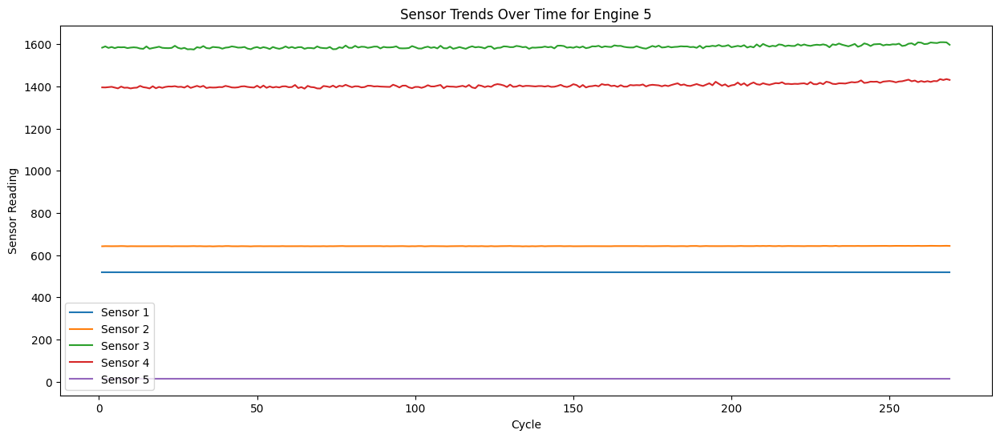

In [14]:
unit_df = df[df['unit'] == 5]

plt.figure(figsize=(15, 6))
for i in range(1, 6):  # Plot 5 sensors
    plt.plot(unit_df['time_in_cycles'], unit_df[f'sensor_{i}'], label=f'Sensor {i}')
plt.title('Sensor Trends Over Time for Engine 5')
plt.xlabel('Cycle')
plt.ylabel('Sensor Reading')
plt.legend()
plt.show()


In [15]:
from sklearn.feature_selection import VarianceThreshold

selector = VarianceThreshold(threshold=0.01)
selector.fit(df[sensor_cols])
selected_features = [sensor_cols[i] for i in range(len(sensor_cols)) if selector.get_support()[i]]

print("Selected Features:", selected_features)


Selected Features: ['sensor_2', 'sensor_3', 'sensor_4', 'sensor_7', 'sensor_9', 'sensor_11', 'sensor_12', 'sensor_14', 'sensor_17', 'sensor_20', 'sensor_21']


## 🔍 EDA Summary

- Total Units: 100
- Max Failure Cycle: 362
- Some sensors show strong downward trends as engines age.
- Highly correlated sensors removed or reduced for modeling.
- RUL computed for each engine → used for supervised learning later.


Text(0.5, 1.02, 'Pairwise Sensor Interactions (Engine 10)')

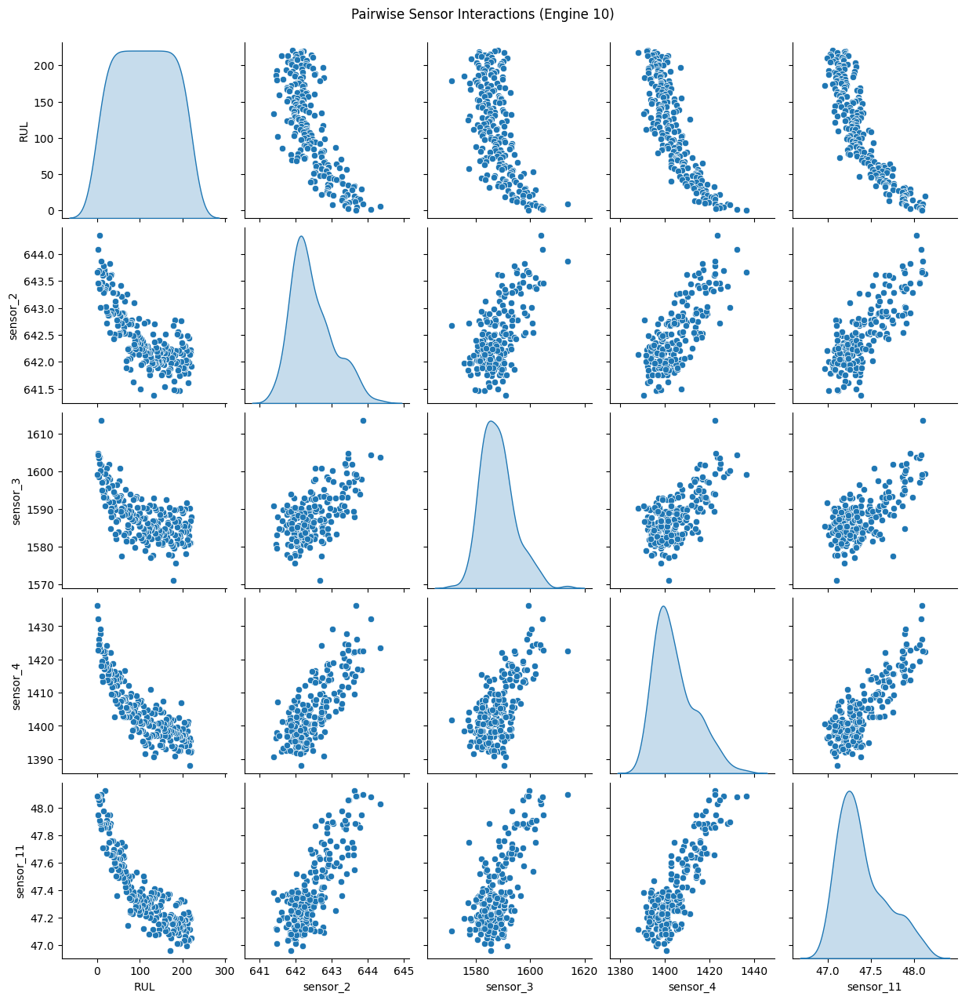

In [17]:
subset = df[df['unit'] == 10][['RUL', 'sensor_2', 'sensor_3', 'sensor_4', 'sensor_11']]
sns.pairplot(subset, diag_kind='kde')
plt.suptitle("Pairwise Sensor Interactions (Engine 10)", y=1.02)

Text(0.5, 1.0, 'RUL Progression for All Engines')

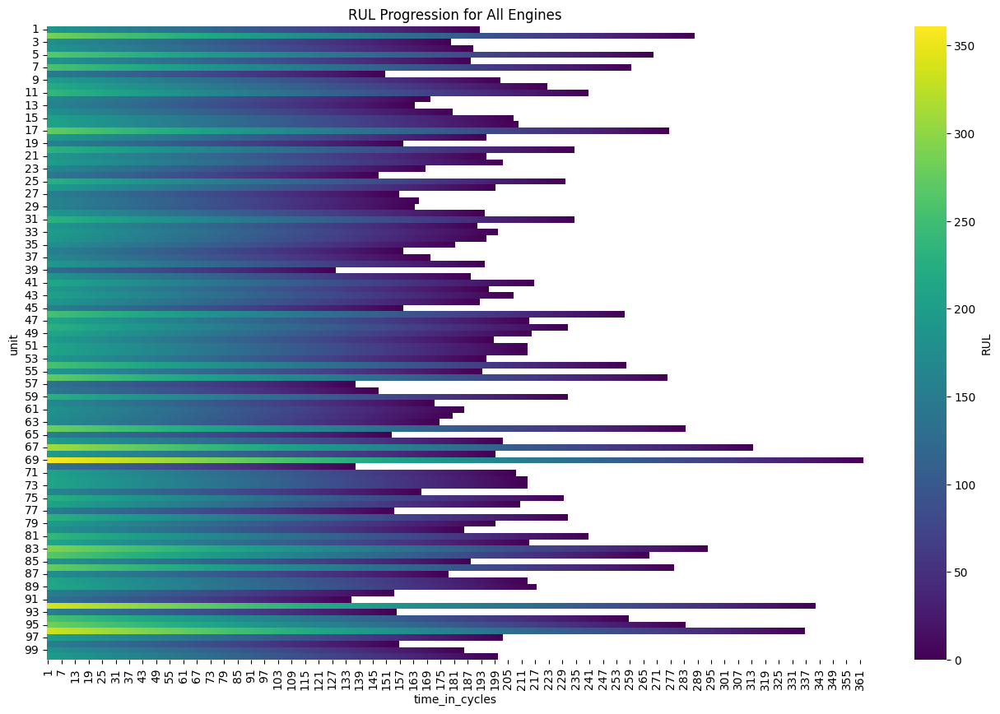

In [18]:
pivot_df = df.pivot(index='unit', columns='time_in_cycles', values='RUL')
plt.figure(figsize=(16, 10))
sns.heatmap(pivot_df, cmap='viridis', cbar_kws={'label': 'RUL'})
plt.title("RUL Progression for All Engines")


In [19]:
!pip install plotly
import plotly.express as px

sample_unit_df = df[df['unit'] == 3]
fig = px.line(sample_unit_df, x='time_in_cycles', y='sensor_11', title="Interactive Sensor 11 Over Time", labels={'time_in_cycles':'Cycle'})
fig.show()


Text(0.5, 1.0, 'Top 10 Sensor Features for RUL Prediction')

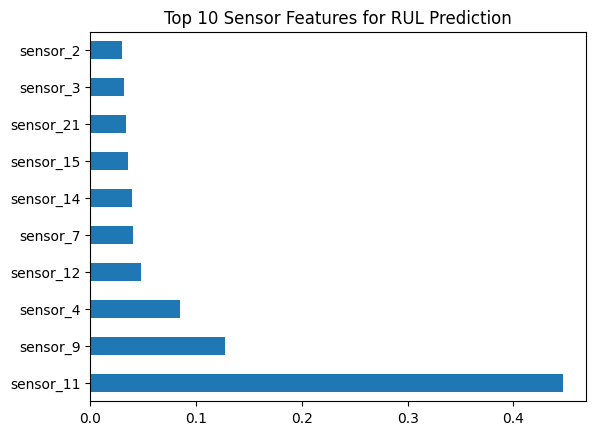

In [34]:
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split

X = df[sensor_cols]
y = df['RUL']

model = RandomForestRegressor(n_estimators=100)
model.fit(X, y)

importances = pd.Series(model.feature_importances_, index=sensor_cols)
importances.nlargest(10).plot(kind='barh')
plt.title("Top 10 Sensor Features for RUL Prediction")


In [35]:
!pip install ydata-profiling
from ydata_profiling import ProfileReport

profile = ProfileReport(df.drop(columns=['unit']), title="NASA Engine EDA", explorative=True)
profile.to_notebook_iframe()


  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 7.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 11.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 14.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 3.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 1.1 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=522683bc8b7508c7f10a64004328532433dd6e1486d9738ba4013d6d75f9e7fb
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 26/26 [00:02<00:00, 10.98it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]